In [ ]:
import pandas as pd
import os
import glob
#path = r'C:\Users\gundr\OneDrive\Desktop\DataSource_12-19 till now' # use your path
#all_files = glob.glob(path + "/*.txt")

li = []

#for filename in all_files:
#    df = pd.read_csv(filename, index_col=None, header=0)
#    li.append(df)

data = pd.concat(li, axis=0, ignore_index=True)


df_filter = pd.DataFrame(data)
df_filter = data.filter(["latitude","longitude","acq_date","frp"])
df_filter.head()
data_topaffected = df_filter.sort_values(by='frp',ascending=False)
data_topaffected

    

In [9]:
from folium.plugins import HeatMapWithTime
import folium
# A small function to get heat map with time given the data

def getmap(ip_data,location,zoom,radius):
    
    #get day list
    dfmap = ip_data[['acq_date','latitude','longitude','frp']]
    df_day_list = []
    for day in dfmap.acq_date.sort_values().unique():
        df_day_list.append(dfmap.loc[dfmap.acq_date == day, ['acq_date','latitude', 'longitude', 'frp']].
                           groupby(['latitude', 'longitude']).sum().reset_index().values.tolist())
    
    # Create a map using folium
    m = folium.Map(location, zoom_start=zoom,tiles='Stamen Terrain')
    #creating heatmap with time
    HeatMapWithTime(df_day_list,index =list(dfmap.acq_date.sort_values().unique()), auto_play=False,
                    radius=radius, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'},
                    min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(m)

    return m
get_map = getmap(data_topaffected,[-27,132],3.5,3)
get_map

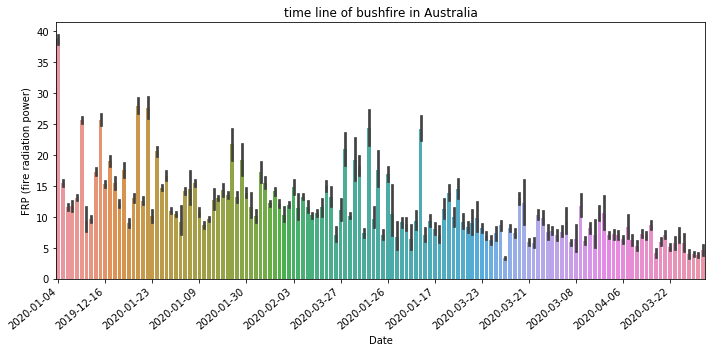

In [9]:
import matplotlib.pyplot as plt 
import seaborn as sns
plt.figure(figsize=(10,5))
sns.set_palette("pastel")
ax = sns.barplot(x='acq_date',y='frp',data=data_topaffected)
set_tick = []
set_label = []
for ind, label in enumerate(ax.get_xticklabels()):
    if ind % 10 == 0:
        set_tick.append(ind)
        set_label.append(label)
        
ax.set_xticks(set_tick)     
ax.set_xticklabels(set_label, rotation=40, ha="right")
plt.xlabel("Date")
plt.ylabel('FRP')
plt.title("time series of Australia bush fire")
plt.tight_layout()

In [2]:
#df_filter['lat_long'] = df_filter[['latitude','longitude']].apply(tuple, axis=1)
aaa = df_filter[['latitude','longitude']].apply(tuple, axis=1)
aaa = aaa.tolist()

#data_tolist = df_filter['lat_long'].unique()
#data_tolist

In [169]:
for i in aaa[:10]:
    print(i)

NameError: name 'aaa' is not defined

In [77]:
from weatherbit.api import Api
api_key = "YOUR API KEY"

   
api = Api('77c82ceaa9004a7e804b21f2dc963246')
api.set_granularity('daily')

for i in data_tolist:
    lat = i[0]
    lon = i[1]
    api.set_granularity('daily')
    history = api.get_history(lat=lat, lon=lon, start_date='2019-12-01',end_date='2020-12-31')
    b = history.get_series(['precip','temp','rh'])
    print(b)


HTTPError: 400 Client Error: Bad Request for url: https://api.weatherbit.io/v2.0/history/daily?key=77c82ceaa9004a7e804b21f2dc963246&lat=-35.81747&lon=148.40386999999998&start_date=2019-12-01&end_date=2020-12-31

In [46]:
from weatherbit.api import Api
api_key = "YOUR API KEY"
lat = -35.81747
lon = 148.40387
   
api = Api('77c82ceaa9004a7e804b21f2dc963246')

# Set the granularity of the API - Options: ['daily','hourly','3hourly']
# Will only affect forecast requests.
api.set_granularity('daily')

# Query by lat/lon
#forecast = api.get_forecast(lat=lat, lon=lon)

# You can also query by city:
#forecast = api.get_forecast(city="Raleigh,NC")

# Or City, state, and country:
#forecast = api.get_forecast(city="Raleigh", state="North Carolina", country="US")

# To get a daily forecast of temperature, and precipitation:
print(forecast.get_series(['temp','precip'])) 

# Get daily history by lat/lon:
api.set_granularity('daily')
history = api.get_history(lat=lat, lon=lon, start_date='2019-12-01',end_date='2020-04-23')

# To get a daily time series of temperature, precipitation, and rh:
print(history.get_series(['precip','temp','rh']))

# Get hourly history by lat/lon
#api.set_granularity('hourly')
#history = api.get_history(lat=lat, lon=lon, start_date='2018-02-01',end_date='2018-02-02')

# To get an hourly time series of temperature, precipitation, and rh:
#print(history.get_series(['precip','temp','rh']))


[{'temp': 8.5, 'precip': 5.5, 'datetime': datetime.datetime(2020, 4, 24, 0, 0)}, {'temp': 8.8, 'precip': 0.0625, 'datetime': datetime.datetime(2020, 4, 25, 0, 0)}, {'temp': 8.3, 'precip': 7.625, 'datetime': datetime.datetime(2020, 4, 26, 0, 0)}, {'temp': 7.6, 'precip': 0, 'datetime': datetime.datetime(2020, 4, 27, 0, 0)}, {'temp': 8.3, 'precip': 0.125, 'datetime': datetime.datetime(2020, 4, 28, 0, 0)}, {'temp': 9.5, 'precip': 72.9375, 'datetime': datetime.datetime(2020, 4, 29, 0, 0)}, {'temp': 1.5, 'precip': 11.4375, 'datetime': datetime.datetime(2020, 4, 30, 0, 0)}, {'temp': 1.2, 'precip': 1.9375, 'datetime': datetime.datetime(2020, 5, 1, 0, 0)}, {'temp': 3, 'precip': 0.5, 'datetime': datetime.datetime(2020, 5, 2, 0, 0)}, {'temp': 4.7, 'precip': 1.25, 'datetime': datetime.datetime(2020, 5, 3, 0, 0)}, {'temp': 2.4, 'precip': 0, 'datetime': datetime.datetime(2020, 5, 4, 0, 0)}, {'temp': 5.4, 'precip': 0, 'datetime': datetime.datetime(2020, 5, 5, 0, 0)}, {'temp': 5.8, 'precip': 0.0625, '

HTTPError: 400 Client Error: Bad Request for url: https://api.weatherbit.io/v2.0/history/daily?key=77c82ceaa9004a7e804b21f2dc963246&lat=-35.81747&lon=148.40387&start_date=2019-12-01&end_date=2020-04-23

In [42]:
import requests
rep = requests.get('http://api.openweathermap.org/data/2.5/forecast?lat=35&lon=139&appid=7814b75cb5a71c7563b6bcc09ff7fc8d')
print(rep.json())

{'cod': '200', 'message': 0, 'cnt': 40, 'list': [{'dt': 1587654000, 'main': {'temp': 279.9, 'feels_like': 276.32, 'temp_min': 279.9, 'temp_max': 281.04, 'pressure': 1009, 'sea_level': 1010, 'grnd_level': 981, 'humidity': 69, 'temp_kf': -1.14}, 'weather': [{'id': 802, 'main': 'Clouds', 'description': 'scattered clouds', 'icon': '03n'}], 'clouds': {'all': 27}, 'wind': {'speed': 2.6, 'deg': 117}, 'sys': {'pod': 'n'}, 'dt_txt': '2020-04-23 15:00:00'}, {'dt': 1587664800, 'main': {'temp': 281.47, 'feels_like': 278.21, 'temp_min': 281.47, 'temp_max': 281.95, 'pressure': 1010, 'sea_level': 1010, 'grnd_level': 982, 'humidity': 69, 'temp_kf': -0.48}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'clouds': {'all': 57}, 'wind': {'speed': 2.51, 'deg': 113}, 'sys': {'pod': 'n'}, 'dt_txt': '2020-04-23 18:00:00'}, {'dt': 1587675600, 'main': {'temp': 282.09, 'feels_like': 278.73, 'temp_min': 282.09, 'temp_max': 282.23, 'pressure': 1012, 'sea_level': 1012, 'g

In [71]:
from pygeocoder import Geocoder
#df_filter = pd.DataFrame(data)

#for i in df_filter:
#df_filter['location_name'] = Geocoder.reverse_geocode(df_filter['latitude'][0], df_filter['longitude'][0])
bbbb = Geocoder.reverse_geocode(-42, 147)

GeocoderError: Error REQUEST_DENIED
Query: https://maps.google.com/maps/api/geocode/json?latlng=-42.000000%2C147.000000&sensor=false&bounds=&region=&language=

In [76]:
ddd = pd.DataFrame(data)
ddd.to_csv('C:\\Users\\gundr\\Downloads\\Aus_bushfire.csv', encoding='utf-8')

In [79]:
import reverse_geocoder as rg
import pprint as pp
#for i in aaa[:1]:
#    print(i)
#    pp.pprint(rg.search(i))
reverse_geo = df_filter[['latitude','longitude']].apply(tuple, axis=1)
reverse_geo = reverse_geo.tolist()
    
results = rg.search(reverse_geo[:2])
pp.pprint(results)



[OrderedDict([('lat', '-42.78161'),
              ('lon', '147.56267'),
              ('name', 'Sorell'),
              ('admin1', 'Tasmania'),
              ('admin2', 'Sorell'),
              ('cc', 'AU')]),
 OrderedDict([('lat', '-42.78161'),
              ('lon', '147.56267'),
              ('name', 'Sorell'),
              ('admin1', 'Tasmania'),
              ('admin2', 'Sorell'),
              ('cc', 'AU')])]


In [158]:
import itertools  
import re
#type(results)
f = open('C:\\Users\\gundr\\OneDrive\\Desktop\\DataSource_12-19 till now\\New folder\latlong.txt', 'w')
for value in results: 
    f.write('\n')
    for item in value.items():
        f.write(item[1])
        f.write(',')
f.close() 
        


In [178]:
import collections
rd = pd.read_csv(r"C:\Users\gundr\OneDrive\Desktop\DataSource_12-19 till now\New folder\New folder (2)\Aus_bushfire.csv",index_col=False)
longlat = pd.DataFrame(rd)
a = longlat['Sub Urban'].unique().tolist()
#collections.Counter(a)
a.sort()

In [181]:
list_of_loc = []
for x in a:
    if (any(c.isspace() for c in x) == False):
        list_of_loc.append(x)
list_of_loc
    

['Alexandra',
 'Allansford',
 'Alyangula',
 'Anglesea',
 'Ararat',
 'Ardrossan',
 'Armidale',
 'Ascot',
 'Atherton',
 'Augusta',
 'Australind',
 'Ayr',
 'Bairnsdale',
 'Balaklava',
 'Ballina',
 'Beaconsfield',
 'Bedfordale',
 'Beeliar',
 'Bega',
 'Bellingen',
 'Benalla',
 'Bermagui',
 'Berridale',
 'Berriedale',
 'Berrigan',
 'Berry',
 'Bertram',
 'Beverley',
 'Biloela',
 'Bingara',
 'Birdwood',
 'Birkenhead',
 'Blackheath',
 'Blackwater',
 'Blaxland',
 'Blayney',
 'Boambee',
 'Boggabilla',
 'Boggabri',
 'Bomaderry',
 'Bombala',
 'Bongaree',
 'Bonville',
 'Boorowa',
 'Bordertown',
 'Boulder',
 'Bourke',
 'Bowen',
 'Bowenfels',
 'Bowral',
 'Bowraville',
 'Boyanup',
 'Braidwood',
 'Branxton',
 'Brewarrina',
 'Bridgetown',
 'Bridgewater',
 'Bridport',
 'Brooklyn',
 'Broome',
 'Broulee',
 'Buderim',
 'Bulahdelah',
 'Bullsbrook',
 'Bunbury',
 'Bundaberg',
 'Bundamba',
 'Bundanoon',
 'Bungendore',
 'Bunyip',
 'Burnie',
 'Burpengary',
 'Burringbar',
 'Burswood',
 'Buxton',
 'Caboolture',
 'Ca

In [279]:
#df_filter.join(longlat)
#pd.concat([df_filter,longlat], axis=1, ignore_index=True)
#longlat.to_csv('C:\\Users\\gundr\\Downloads\\country.csv', encoding='utf-8')
index = list_of_loc.index('Zillmere')
print(index)

462


In [82]:
#cleaning 
final = pd.read_csv("C:\\Users\\gundr\\OneDrive\\Desktop\\DataSource_12-19 till now\\New folder\\New folder (2)\\Aus_bushfire.csv",index_col=None)
df = pd.DataFrame(final)
df.info()
df = df[df['Country'] == 'AU']
df.to_csv('C:\\Users\\gundr\\Downloads\\Final_dataset.csv', encoding='utf-8')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 674554 entries, 0 to 674553
Data columns (total 21 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Unnamed: 0    674554 non-null  int64  
 1   Unnamed: 0.1  674554 non-null  int64  
 2   latitude      674554 non-null  float64
 3   longitude     674554 non-null  float64
 4   bright_ti4    674554 non-null  float64
 5   scan          674554 non-null  float64
 6   track         674554 non-null  float64
 7   acq_date      674554 non-null  object 
 8   acq_time      674554 non-null  object 
 9   satellite     674554 non-null  int64  
 10  confidence    674554 non-null  object 
 11  version       674554 non-null  object 
 12  bright_ti5    674554 non-null  float64
 13  frp           674554 non-null  float64
 14  daynight      674554 non-null  object 
 15  new lat       674554 non-null  float64
 16  new long      674554 non-null  float64
 17  Sub Urban     674554 non-null  object 
 18  Stat

In [282]:
#https://www.worldweatheronline.com/developer/my/subscription/
import os
from wwo_hist import retrieve_hist_data
os.chdir(r"C:\\Users\\gundr\\OneDrive\\Desktop\\DataSource_12-19 till now\\New folder\\new data")
frequency=4
start_date = '4-DEC-2019'
end_date = '20-APRIL-2020'
api_key = '5895d1245852471799f100200202704'
location_list = list_of_loc[463:]


hist_weather_data = retrieve_hist_data(api_key,
                                location_list,
                                start_date,
                                end_date,
                                frequency,
                                location_label = True,
                                export_csv = True,
                                store_df = False)

In [283]:
import os 
import re
import pandas as pd
import glob

path = r'C:\Users\gundr\OneDrive\Desktop\DataSource_12-19 till now\New folder/'
all_files = glob.glob(path + "/*.csv")

appenddata = []
for filename in all_files:
        file = os.path.basename(filename)[:-4]
        open_file = pd.read_csv(filename)
        df = pd.DataFrame(open_file)
        df['Sub Urban'] = file
        col = []
        for i in df.columns.tolist():
            col.append(i.replace(file + "_",""))
        df.columns = col   
        count = 0
        appenddata.append(df)
appenddata = pd.concat(appenddata)


appenddata.sort_values(by=['Sub Urban'], inplace=True)
appenddata.reset_index(inplace = True, drop = True)
appenddata.head()

,date_time,maxtempC,mintempC,totalSnow_cm,sunHour,uvIndex,uvIndex.1,moon_illumination,moonrise,moonset,...,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph,Sub Urban
0,2019-12-04 00:00:00,14,4,0.0,11.3,2,1,48,11:39 AM,12:41 AM,...,10,86,98,0.3,1009,4,3,277,8,Alexandra
1,2020-03-04 12:00:00,16,9,0.0,7.6,4,4,65,02:44 PM,No moonset,...,5,64,81,0.8,1015,15,10,35,4,Alexandra
2,2020-03-04 15:00:00,16,9,0.0,7.6,4,3,65,02:44 PM,No moonset,...,6,87,96,2.7,1012,14,8,57,3,Alexandra
3,2020-03-04 18:00:00,16,9,0.0,7.6,4,1,65,02:44 PM,No moonset,...,8,99,99,4.4,1012,13,7,89,4,Alexandra
4,2020-03-04 21:00:00,16,9,0.0,7.6,4,1,65,02:44 PM,No moonset,...,10,99,99,9.7,1011,13,6,89,5,Alexandra


In [284]:
bushpath = r"C:\Users\gundr\OneDrive\Desktop\DataSource_12-19 till now\New folder\New folder (2)\Aus_bushfire.csv"
readbush = pd.read_csv(bushpath, index_col = 0)
df_bush = pd.DataFrame(readbush)
df_bush.drop("Unnamed: 0.1", axis = 1, inplace = True)
df_bush['date_time'] = df_bush['acq_date'].str.cat(df_bush['acq_time'],sep=" ")
df_bush.sort_values(by=['Sub Urban'], inplace=True)
df_bush.reset_index(inplace = True, drop = True)
df_bush.head()

,latitude,longitude,bright_ti4,scan,track,acq_date,acq_time,satellite,confidence,version,bright_ti5,frp,daynight,new lat,new long,Sub Urban,State,Region,Country,date_time
0,-31.86201,115.88184,332.4,0.42,0.45,07-01-2020,05:36,1,low,1.0NRT,307.2,2.9,D,-31.82758,115.86501,Alexander Heights,Western Australia,Wanneroo,AU,07-01-2020 05:36
1,-37.09116,145.37335,335.9,0.54,0.42,25-03-2020,04:30,1,nominal,1.0NRT,296.0,4.1,D,-37.19132,145.71120,Alexandra,Victoria,Murrindindi,AU,25-03-2020 04:30
2,-37.36719,145.83859,367.0,0.43,0.38,16-04-2020,04:18,1,high,1.0NRT,341.6,355.4,D,-37.19132,145.71120,Alexandra,Victoria,Murrindindi,AU,16-04-2020 04:18
3,-37.06285,145.50400,296.0,0.39,0.44,16-04-2020,15:36,1,nominal,1.0NRT,278.6,0.4,N,-37.19132,145.71120,Alexandra,Victoria,Murrindindi,AU,16-04-2020 15:36
4,-36.90592,145.45830,328.4,0.39,0.36,11-04-2020,04:12,1,nominal,1.0NRT,286.2,1.6,D,-37.19132,145.71120,Alexandra,Victoria,Murrindindi,AU,11-04-2020 04:12


In [285]:
#df_bush           appenddata
from datetime import *

appenddata['date_time'] = pd.to_datetime(appenddata['date_time'])
appenddata['date_time'] = appenddata['date_time'].apply(lambda t: t.strftime('%Y-%m-%d %H:%M'))

df_bush['date_time'] = pd.to_datetime(df_bush['date_time'])
df_bush['date_time'] = df_bush['date_time'].apply(lambda t: t.strftime('%d-%m-%Y %H:%M'))

In [286]:
df_bush['date_time'] = pd.to_datetime(df_bush['date_time'])
df_bush['date_time'] = df_bush['date_time'].apply(lambda t: t.strftime('%Y-%m-%d %H:%M'))

df_bush.drop(['acq_date','acq_time'], axis = 1)
df_bush

,latitude,longitude,bright_ti4,scan,track,acq_date,acq_time,satellite,confidence,version,bright_ti5,frp,daynight,new lat,new long,Sub Urban,State,Region,Country,date_time
0,-31.86201,115.88184,332.4,0.42,0.45,07-01-2020,05:36,1,low,1.0NRT,307.2,2.9,D,-31.82758,115.86501,Alexander Heights,Western Australia,Wanneroo,AU,2020-01-07 05:36
1,-37.09116,145.37335,335.9,0.54,0.42,25-03-2020,04:30,1,nominal,1.0NRT,296.0,4.1,D,-37.19132,145.71120,Alexandra,Victoria,Murrindindi,AU,2020-03-25 04:30
2,-37.36719,145.83859,367.0,0.43,0.38,16-04-2020,04:18,1,high,1.0NRT,341.6,355.4,D,-37.19132,145.71120,Alexandra,Victoria,Murrindindi,AU,2020-04-16 04:18
3,-37.06285,145.50400,296.0,0.39,0.44,16-04-2020,15:36,1,nominal,1.0NRT,278.6,0.4,N,-37.19132,145.71120,Alexandra,Victoria,Murrindindi,AU,2020-04-16 15:36
4,-36.90592,145.45830,328.4,0.39,0.36,11-04-2020,04:12,1,nominal,1.0NRT,286.2,1.6,D,-37.19132,145.71120,Alexandra,Victoria,Murrindindi,AU,2020-04-11 04:12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
674549,-34.29464,148.11153,306.1,0.50,0.41,07-03-2020,14:48,1,nominal,1.0NRT,284.6,0.8,N,-34.31350,148.30107,Young,New South Wales,Young,AU,2020-03-07 14:48
674550,-34.29354,148.10606,297.5,0.50,0.41,07-03-2020,14:48,1,nominal,1.0NRT,284.7,0.8,N,-34.31350,148.30107,Young,New South Wales,Young,AU,2020-03-07 14:48
674551,-34.36961,148.19618,341.8,0.58,0.70,15-04-2020,02:54,1,nominal,1.0NRT,290.5,8.2,D,-34.31350,148.30107,Young,New South Wales,Young,AU,2020-04-15 02:54
674552,-34.08949,148.31946,296.5,0.62,0.54,20-03-2020,15:42,1,nominal,1.0NRT,284.2,0.8,N,-34.31350,148.30107,Young,New South Wales,Young,AU,2020-03-20 15:42


In [306]:
sublist = appenddata['Sub Urban'].unique().tolist()
sublist
        
    

['Alexandra',
 'Allansford',
 'Alyangula',
 'Anglesea',
 'Ararat',
 'Ardrossan',
 'Armidale',
 'Ascot',
 'Atherton',
 'Augusta',
 'Australind',
 'Ayr',
 'Bairnsdale',
 'Balaklava',
 'Ballina',
 'Beaconsfield',
 'Bedfordale',
 'Bega',
 'Bellingen',
 'Benalla',
 'Bermagui',
 'Berridale',
 'Berriedale',
 'Berrigan',
 'Berry',
 'Bertram',
 'Beverley',
 'Biloela',
 'Bingara',
 'Birdwood',
 'Birkenhead',
 'Blackheath',
 'Blackwater',
 'Blaxland',
 'Blayney',
 'Boambee',
 'Boggabilla',
 'Boggabri',
 'Bomaderry',
 'Bombala',
 'Bongaree',
 'Bonville',
 'Boorowa',
 'Bordertown',
 'Boulder',
 'Bourke',
 'Bowen',
 'Bowenfels',
 'Bowral',
 'Bowraville',
 'Boyanup',
 'Braidwood',
 'Branxton',
 'Brewarrina',
 'Bridgetown',
 'Bridgewater',
 'Bridport',
 'Brooklyn',
 'Broome',
 'Broulee',
 'Buderim',
 'Bulahdelah',
 'Bullsbrook',
 'Bunbury',
 'Bundaberg',
 'Bundamba',
 'Bundanoon',
 'Bungendore',
 'Bunyip',
 'Burnie',
 'Burpengary',
 'Burringbar',
 'Buxton',
 'Caboolture',
 'Callington',
 'Caloundra',


In [347]:
df_bush_dump = df_bush
mergeall = []
count = 0
prev_value = ""
for a in df_bush_dup['Sub Urban']:
#    print(a)
    if a in sublist:
#        print("bbb")
        
        if ((a != prev_value) | (count == 0)) :
            count = 1
#            print("..........")
            appenddata['date_time'] = pd.to_datetime(appenddata['date_time']) 
            df_bush['date_time'] = pd.to_datetime(df_bush['date_time'])
            x = df_bush_dump[df_bush_dump['Sub Urban'] == a]
            y = appenddata[appenddata['Sub Urban'] == a]
            merged = pd.merge_asof(x.sort_values(by = 'date_time'),
                                   y.sort_values(by = 'date_time'),
                                   on='date_time',
                                   tolerance=pd.Timedelta("120 minutes"),
                                   direction='nearest')
            mergeall.append(merged)
            prev_value = a



In [349]:
mergeall = pd.concat(mergeall)
mergeall.to_csv('C:\\Users\\gundr\\OneDrive\\Desktop\\DataSource_12-19 till now\\New folder\\New folder (2)\\merge.csv',
              encoding='utf-8')


In [353]:
re = pd.read_csv('C:\\Users\\gundr\\OneDrive\\Desktop\\DataSource_12-19 till now\\New folder\\New folder (2)\\merge.csv',
             index_col = 0)
ree = pd.DataFrame(re)
ree.drop(['date_time','Sub Urban_y'], axis = 1, inplace = True)
ree

,latitude,longitude,bright_ti4,scan,track,acq_date,acq_time,satellite,confidence,version,...,WindChillC,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph
0,-37.23460,145.90694,336.4,0.4,0.44,29-01-2020,03:42,1,low,1.0NRT,...,11,8,0,62,0.0,1016,11,10,136,4
1,-37.39335,145.89616,337.8,0.4,0.37,16-03-2020,04:00,1,nominal,1.0NRT,...,4,11,5,82,0.0,1026,5,10,112,5
2,-37.39185,145.89191,300.7,0.4,0.37,16-03-2020,15:18,1,nominal,1.0NRT,...,19,5,7,36,0.0,1024,19,10,262,4
3,-37.38438,145.90166,342.7,0.4,0.44,17-03-2020,03:42,1,nominal,1.0NRT,...,9,6,13,76,0.0,1026,9,10,79,3
4,-37.38489,145.89644,353.6,0.4,0.44,17-03-2020,03:42,1,nominal,1.0NRT,...,9,6,13,76,0.0,1026,9,10,79,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34,-34.17207,148.30626,345.6,0.4,0.37,17-04-2020,04:00,1,nominal,1.0NRT,...,-3,11,55,64,0.0,1027,-1,10,256,6
35,-34.29503,148.17804,338.7,0.4,0.37,17-04-2020,04:00,1,nominal,1.0NRT,...,-3,11,55,64,0.0,1027,-1,10,256,6
36,-34.17349,148.29767,329.5,0.4,0.37,17-04-2020,04:00,1,nominal,1.0NRT,...,-3,11,55,64,0.0,1027,-1,10,256,6
37,-34.29168,148.17726,341.2,0.4,0.37,17-04-2020,04:00,1,nominal,1.0NRT,...,-3,11,55,64,0.0,1027,-1,10,256,6


In [354]:
ree.to_csv('C:\\Users\\gundr\\OneDrive\\Desktop\\DataSource_12-19 till now\\New folder\\New folder (2)\\BushFire_weather.csv',
              encoding='utf-8')

# Prediction model

In [10]:
from sklearn.ensemble import RandomForestRegressor as RFR
from sklearn.metrics import roc_auc_score
import pandas as pd

In [237]:
pre = pd.read_csv(r"C:\Users\gundr\OneDrive\Desktop\DataSource_12-19 till now\New folder\New folder (2)\BushFire_weather.csv", index_col = 0)


In [236]:
df = pd.DataFrame(pre)
df = df[df['State'] == 'Victoria']
df = df[['frp','new lat', 'new long','tempC','humidity','windspeedKmph','pressure']]
#model = df.drop(['new lat', 'new long'], axis = 1)
x = df.drop(['frp'], axis = 1)
y = df['frp']


In [235]:
df = pd.DataFrame(pre)
df = df[df['State'] == 'Victoria']
df1 = df[['frp','tempC','humidity','windspeedKmph','pressure','Sub Urban_x']]
features = pd.get_dummies(df1['Sub Urban_x'])
print(features)

    Alexandra  Allansford  Anglesea  Ararat  Bairnsdale  Benalla  Brooklyn  \
0           1           0         0       0           0        0         0   
1           1           0         0       0           0        0         0   
2           1           0         0       0           0        0         0   
3           1           0         0       0           0        0         0   
4           1           0         0       0           0        0         0   
..        ...         ...       ...     ...         ...      ...       ...   
55          0           0         0       0           0        0         0   
56          0           0         0       0           0        0         0   
57          0           0         0       0           0        0         0   
58          0           0         0       0           0        0         0   
59          0           0         0       0           0        0         0   

    Bunyip  Castlemaine  Cockatoo  ...  Thomastown  Tooradin  T

In [223]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 50)

test = RFR(n_estimators = 100, oob_score = True, random_state = 50)
test.fit(x_train, y_train)

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=None, oob_score=True,
                      random_state=50, verbose=0, warm_start=False)

In [224]:
predict = test.predict(x_test)
print(predict)

[ 1.68675973 43.78770668  2.94475421 ... 17.79506688 43.78770668
 35.15682365]


In [228]:
from sklearn import metrics
test.score(x_train, y_train)

0.2184157776961042

In [226]:
#test.oob_prediction_
test.oob_score_

0.2012963910012262

In [230]:
from sklearn.metrics import accuracy_score
accuracy_score(y_test, predict)

ValueError: continuous is not supported

# using knn

In [144]:
import math
math.sqrt(len(y_train))

109.91815136727874

In [231]:
x = df.drop(['frp'], axis = 1)
y = df['frp']

from sklearn import preprocessing
from sklearn import utils

lab_enc = preprocessing.LabelEncoder()
z = lab_enc.fit_transform(df['frp'])

from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.4, random_state = 50)

In [232]:

from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors = 10, metric = "euclidean", p = 2 )
knn.fit(x_train, y_train)

#Predict the response for test dataset
y_pred = knn.predict(x_test)

In [233]:
from sklearn import metrics
# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.03413604766633565
